In [1]:
import os
import numpy as np

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms

from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid, save_image
from torch.utils.data import DataLoader

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, Image

%matplotlib inline

In [2]:
# If it took to long change the n_epochs
# n_epochs = 100 will take a round 2 hours 40 minutes (when use GPU T4 on Google Collab)
# 1 channels for black and white picture, 3 channels for rgb picture
opt = {
    "n_epochs": 100,
    "batch_size": 128,
    "lr": 0.0002,
    "b1": 0.5,
    "b2": 0.999,
    "n_workers": 2,
    "latent_dim": 100,
    "img_size": 64,
    "channels": 3,
}
print(opt)

{'n_epochs': 100, 'batch_size': 128, 'lr': 0.0002, 'b1': 0.5, 'b2': 0.999, 'n_workers': 2, 'latent_dim': 100, 'img_size': 64, 'channels': 3}


In [19]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("splcher/animefacedataset")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/animefacedataset


In [20]:
!ls /kaggle/input/animefacedataset

images


In [15]:
# Check device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

Using device: cuda


In [21]:
dataroot = "/kaggle/input/animefacedataset"
dataset = ImageFolder(root=dataroot,
                      transform=transforms.Compose([
                          transforms.Resize(opt["img_size"]),
                          transforms.CenterCrop(opt["img_size"]),
                          transforms.ToTensor(),
                          transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))]))
data_loader = DataLoader(dataset, batch_size=opt["batch_size"], shuffle=True, num_workers=opt["n_workers"])

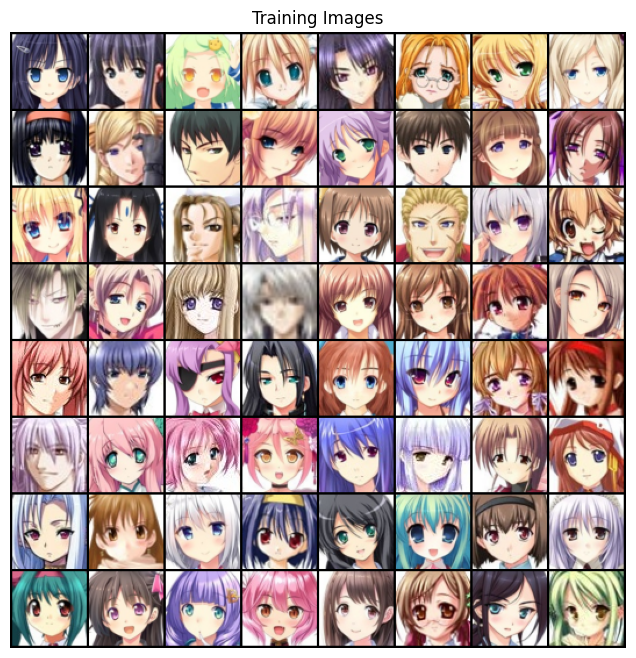

In [22]:
# Plot some training images
real_batch = next(iter(data_loader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(), (1, 2, 0)))

In [23]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

In [24]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.convt1 = self.make_block(in_channels=opt["latent_dim"], out_channels=512, kernel_size=4, stride=1, padding=0)
        self.convt2 = self.make_block(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1)
        self.convt3 = self.make_block(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1)
        self.convt4 = self.make_block(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1)
        self.convt5 = nn.ConvTranspose2d(in_channels=64, out_channels=opt["channels"], kernel_size=4, stride=2, padding=1)
        self.act1 = nn.Tanh()

    def make_block(self, in_channels, out_channels, kernel_size, stride, padding, bias=False):
        return nn.Sequential(nn.ConvTranspose2d(in_channels=in_channels, out_channels=out_channels,
                                                kernel_size=kernel_size, stride=stride,
                                                padding=padding, bias=bias),
                             nn.BatchNorm2d(num_features=out_channels),
                             nn.ReLU(inplace=True))

    def forward(self, input):
        input = self.convt1(input)
        input = self.convt2(input)
        input = self.convt3(input)
        input = self.convt4(input)
        input = self.convt5(input)
        input = self.act1(input)
        return input

In [25]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.conv1 = self.make_block(in_channels=opt["channels"], out_channels=64, kernel_size=4, stride=2, padding=1, bias=False, batchnorm=False)
        self.conv2 = self.make_block(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False, batchnorm=True)
        self.conv3 = self.make_block(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False, batchnorm=True)
        self.conv4 = self.make_block(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False, batchnorm=True)
        self.conv5 = nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False)
        self.act1 = nn.Sigmoid()

    def make_block(self, in_channels, out_channels, kernel_size, stride, padding, bias=False, batchnorm=True):
        layers = [nn.Conv2d(in_channels=in_channels, out_channels=out_channels,
                                     kernel_size=kernel_size, stride=stride,
                                     padding=padding, bias=bias),
                  nn.LeakyReLU(negative_slope=0.2, inplace=True)]
        if batchnorm:
            layers.insert(1, nn.BatchNorm2d(num_features=out_channels))
        return nn.Sequential(*layers)

    def forward(self, input):
        input = self.conv1(input)
        input = self.conv2(input)
        input = self.conv3(input)
        input = self.conv4(input)
        input = self.conv5(input)
        input = self.act1(input)
        return input

In [26]:
# Initialize generator and discriminator
generator = Generator().to(device)
discriminator = Discriminator().to(device)

# Loss functions
adversarial_loss = nn.BCELoss().to(device)

In [27]:
# Initialize weights
generator.apply(weights_init_normal)
discriminator.apply(weights_init_normal)

Discriminator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (conv4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (conv5): Conv2d(512, 1, kernel_size=(4, 4

In [28]:
sample_dir = 'samples'
if not os.path.exists(sample_dir):
    os.makedirs(sample_dir)

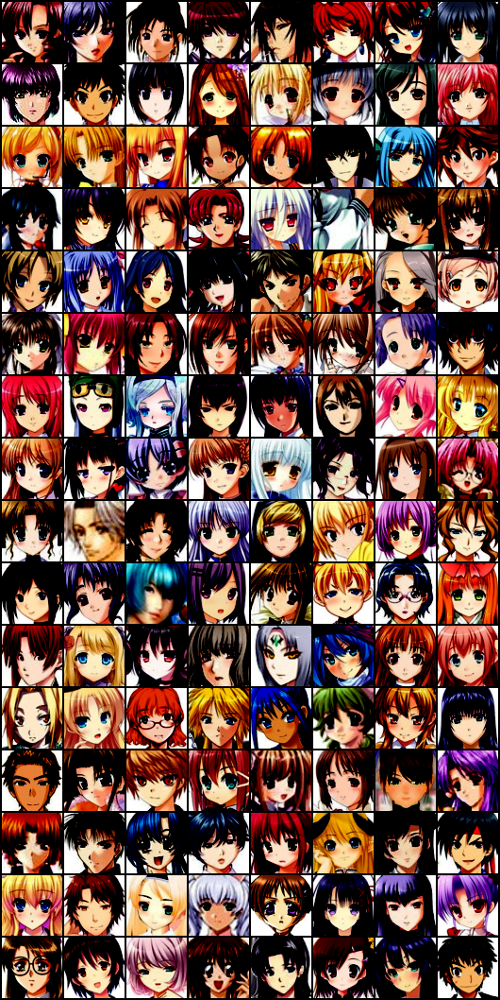

In [29]:
# Save some real images
for images, _ in data_loader:
    images = images.reshape(images.size(0), opt["channels"], opt["img_size"], opt["img_size"])
    images = images.to(device)
    save_image(images, os.path.join(sample_dir, 'real_images.png'), nrow=8)
    break

display(Image(os.path.join(sample_dir, 'real_images.png')))

Saving fake_images-0000.png


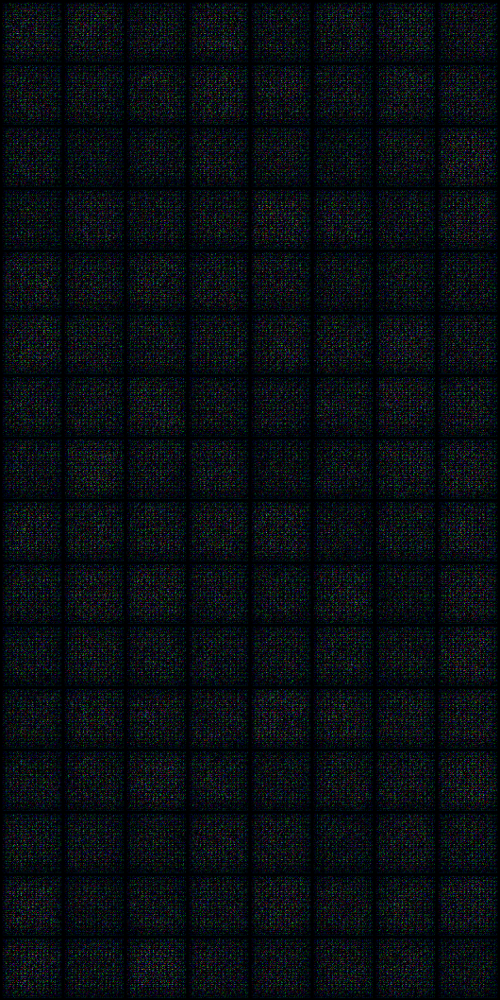

In [30]:
sample_vectors = torch.randn(opt["batch_size"], opt["latent_dim"], 1, 1).to(device)

def save_fake_images(index):
    fake_images = generator(sample_vectors)
    fake_images = fake_images.reshape(fake_images.size(0), opt["channels"], opt["img_size"], opt["img_size"])
    fake_fname = 'fake_images-{0:0=4d}.png'.format(index)
    print('Saving', fake_fname)
    save_image(fake_images, os.path.join(sample_dir, fake_fname), nrow=8)

# Before training
save_fake_images(0)
Image(os.path.join(sample_dir, 'fake_images-0000.png'))

In [32]:
# Optimizers
g_optimizer = torch.optim.Adam(generator.parameters(), lr=opt["lr"], betas=(opt["b1"], opt["b2"]))
d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=opt["lr"], betas=(opt["b1"], opt["b2"]))

In [33]:
# The progression of the generator
fixed_noise = torch.randn(opt["img_size"], opt["latent_dim"], 1, 1).to(device)

# Establish convention for real and fake labels during training
real_label = 1.0
fake_label = 0.0
iters = 0

total_step = len(data_loader)
img_list, d_losses, g_losses, real_scores, fake_scores = [], [], [], [], []

for epoch in range(opt["n_epochs"]):
    for i, (images, _) in enumerate(data_loader):

        ###################################
        # (1) Update Discriminator network: maximize log(d(x)) + log(1 - d(g(z)))
        ###################################
        ## Train with all-real batch
        d_optimizer.zero_grad()
        # Format real images
        images = images.to(device)
        b_size = images.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float).to(device)

        # Forward pass real batch through disciminator
        output = discriminator(images).view(-1)
        d_loss_real = adversarial_loss(output, label)
        d_loss_real.backward()
        # d_x = output.mean().item()
        real_scores.append(output.mean().item())

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, opt["latent_dim"], 1, 1).to(device)
        # Generate fake image batch with generator
        fake_images = generator(noise)
        label.fill_(fake_label)

        # Forward pass fake batch through discriminator
        output = discriminator(fake_images.detach()).view(-1)
        d_loss_fake = adversarial_loss(output, label)
        d_loss_fake.backward()
        # d_g_z1 = output.mean().item()
        fake_scores.append(output.mean().item())

        # Compute total discriminator loss and update
        d_loss = d_loss_real + d_loss_fake
        d_optimizer.step()


        ###################################
        # (2) Update Generator network: maximize log(d(g(z)))
        ###################################
        g_optimizer.zero_grad()
        label.fill_(real_label) # Generator tries to make discriminator believe fake images are real

        # Forward pass fake batch through discriminator
        output = discriminator(fake_images).view(-1)
        g_loss = adversarial_loss(output, label)
        g_loss.backward()
        d_g_z2 = output.mean().item()
        g_optimizer.step()

        # Log losses
        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())


        ############################
        # (3) Logging
        ############################
        if i % 50 == 0:
            print('Epoch [{}/{}], Step [{}/{}], d_loss: {:.4f}, g_loss: {:.4f}, D(x): {:.2f}, D(G(z)): {:.2f} / {:.2f}'
                  .format(epoch, opt["n_epochs"], i, total_step, d_loss.item(), g_loss.item(),
                          real_scores[-1], fake_scores[-1], d_g_z2))


        ############################
        # (4) Save Generated Images
        ############################
        if (iters % 500 == 0) or ((epoch == opt["n_epochs"] - 1) and (i == len(data_loader) - 1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            fake_grid = make_grid(fake, padding=2, normalize=True)
            img_list.append(fake_grid)
            #save_image(fake_grid, os.path.join(sample_dir, f'fake_images-{iters:04d}.png'), nrow=8)
            #print(f"Saved fake_images-{iters:04d}.png")
        iters += 1

Epoch [0/100], Step [0/497], d_loss: 1.6799, g_loss: 3.9539, D(x): 0.43, D(G(z)): 0.45 / 0.03
Epoch [0/100], Step [50/497], d_loss: 0.2081, g_loss: 5.7970, D(x): 0.91, D(G(z)): 0.01 / 0.02
Epoch [0/100], Step [100/497], d_loss: 0.4781, g_loss: 7.2461, D(x): 0.93, D(G(z)): 0.26 / 0.00
Epoch [0/100], Step [150/497], d_loss: 0.1947, g_loss: 7.3079, D(x): 0.90, D(G(z)): 0.04 / 0.00
Epoch [0/100], Step [200/497], d_loss: 0.2659, g_loss: 5.5635, D(x): 0.92, D(G(z)): 0.14 / 0.01
Epoch [0/100], Step [250/497], d_loss: 1.0383, g_loss: 10.0435, D(x): 0.92, D(G(z)): 0.52 / 0.00
Epoch [0/100], Step [300/497], d_loss: 0.7919, g_loss: 5.9340, D(x): 0.96, D(G(z)): 0.46 / 0.01
Epoch [0/100], Step [350/497], d_loss: 0.2651, g_loss: 5.3309, D(x): 0.85, D(G(z)): 0.06 / 0.01
Epoch [0/100], Step [400/497], d_loss: 0.3961, g_loss: 4.5978, D(x): 0.81, D(G(z)): 0.08 / 0.01
Epoch [0/100], Step [450/497], d_loss: 0.2669, g_loss: 3.2686, D(x): 0.85, D(G(z)): 0.04 / 0.09
Epoch [1/100], Step [0/497], d_loss: 0.823

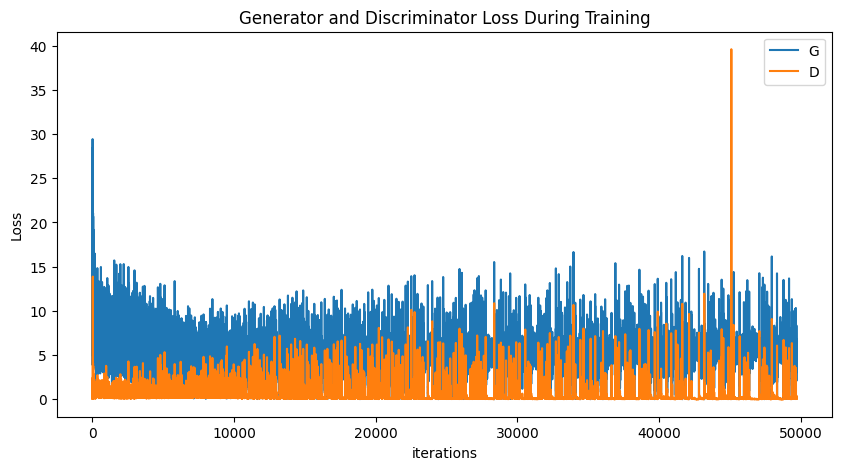

In [34]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(g_losses,label="G")
plt.plot(d_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

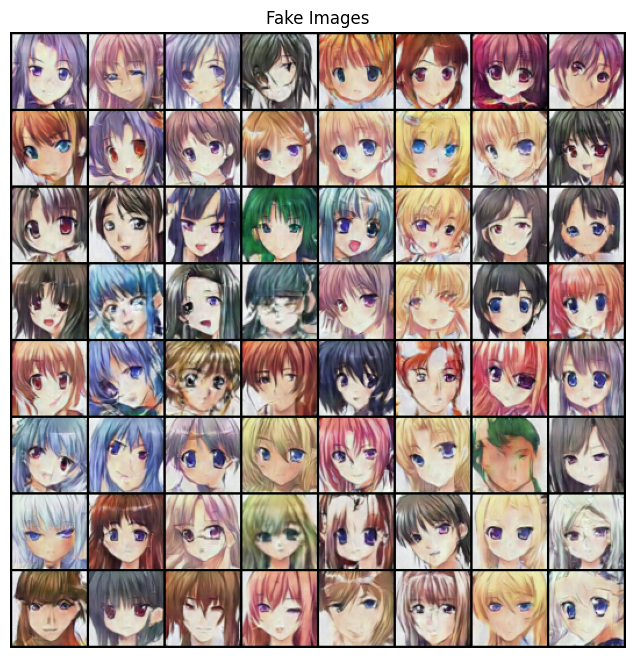

In [35]:
#%%capture
fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
plt.title("Fake Images")
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())
#↓Code to save the animation
#ani.save("sample_anime_new.gif", writer="imagemagick")

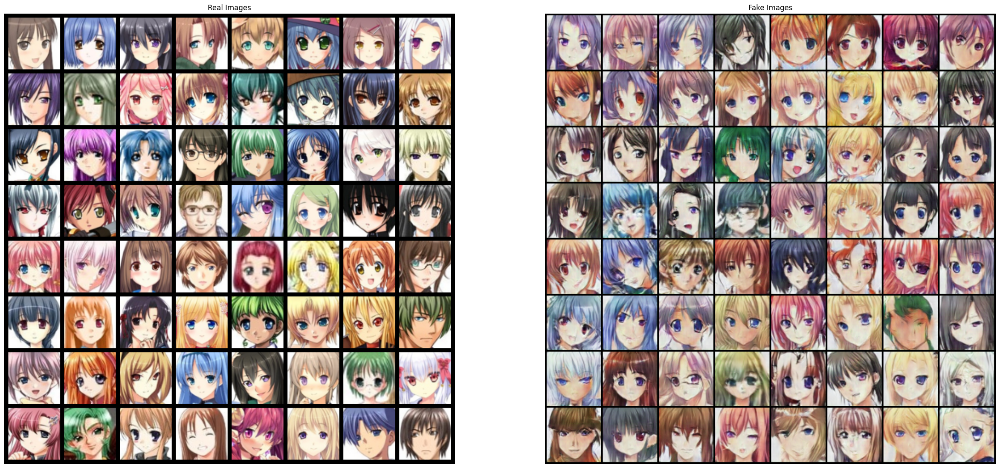

In [36]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(data_loader))

# Plot the real images
plt.figure(figsize=(30, 30))
plt.subplot(1, 2, 1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(), (1, 2, 0)))

# Plot the fake images from the last epoch
plt.subplot(1, 2, 2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1], (1, 2, 0)))
plt.show()
#↓Code to save the image
#fig.savefig("img_anime_old.png")